# Mobile Price Classification

https://www.kaggle.com/iabhishekofficial/mobile-price-classification

In [24]:
#!pip install pandas
#!pip install scikit-learn
#!pip install sweetviz
#!pip install ipywidgets
!pip install xgboost

ERROR: Could not install packages due to an OSError: [WinError 5] Acceso denegado: 'c:\\python39\\xgboost'
Consider using the `--user` option or check the permissions.



In [26]:
#Import libraries
import pandas as pd
import numpy
import math
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import sweetviz as sw
import xgboost as xg

In [3]:
raw_train = pd.read_csv('train.csv')
raw_test = pd.read_csv('test.csv')

In [4]:
raw_train.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [5]:
raw_test.head()

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,...,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,...,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,...,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,...,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,...,18,749,810,1773,15,8,7,1,0,1


In [6]:
raw_all = pd.concat([raw_train, raw_test])

In [7]:
raw_all.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range,id
0,842,0,2.2,0,1,0,7,0.6,188,2,...,756,2549,9,7,19,0,0,1,1.0,NaN
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,1988,2631,17,3,7,1,1,0,2.0,NaN
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1716,2603,11,2,9,1,1,0,2.0,NaN
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1786,2769,16,8,11,1,0,0,2.0,NaN
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1212,1411,8,2,15,1,1,0,1.0,NaN


In [8]:
raw_all = raw_all.reset_index()
raw_all = raw_all.drop(['id','index'], axis=1)

In [9]:
raw_all.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1.0
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2.0
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2.0
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2.0
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1.0


<ipython-input-10-00666a41a45a>:1: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  plt.hist(raw_all.n_cores, edgeColor='black')


(array([380., 381., 373.,   0., 416., 376.,   0., 331., 366., 377.]),
 array([1. , 1.7, 2.4, 3.1, 3.8, 4.5, 5.2, 5.9, 6.6, 7.3, 8. ]),
 <BarContainer object of 10 artists>)

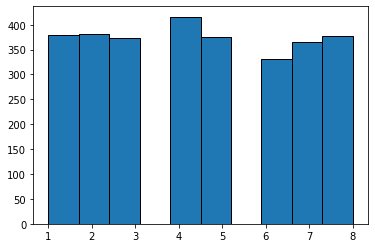

In [10]:
plt.hist(raw_all.n_cores, edgeColor='black')

In [11]:
my_report = sw.analyze(raw_all)
my_report.show_html()

                                             |                                                                …

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [22]:
train, test = train_test_split(raw_all, test_size=0.2)

In [23]:
train.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
575,1197,1,0.5,1,9,0,20,0.1,129,5,...,214,1710,2885,19,7,14,1,1,1,2.0
1328,507,1,1.9,1,0,1,39,0.7,142,1,...,17,1084,2124,6,0,12,1,1,0,1.0
918,979,0,0.5,1,0,1,5,0.5,164,7,...,793,1670,3449,5,2,14,1,0,0,3.0
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2.0
2538,1745,1,1.2,0,3,1,21,0.2,89,3,...,202,1670,3507,18,1,20,1,1,1,NaN


In [29]:
train.isnull().sum()

battery_power      0
blue               0
clock_speed        0
dual_sim           0
fc                 0
four_g             0
int_memory         0
m_dep              0
mobile_wt          0
n_cores            0
pc                 0
px_height          0
px_width           0
ram                0
sc_h               0
sc_w               0
talk_time          0
three_g            0
touch_screen       0
wifi               0
price_range      801
dtype: int64

In [33]:
train.price_range.mode()

0    0.0
dtype: float64

In [37]:
train['price_range'] = train.price_range.fillna(train.price_range.mode())

<ipython-input-37-c52881b4012d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['price_range'] = train.price_range.fillna(train.price_range.mode())


In [38]:
y_pred = KMeans(n_clusters=2).fit_predict(raw_train)

In [39]:
y_pred_3 = KMeans(n_clusters=3).fit_predict(raw_train)

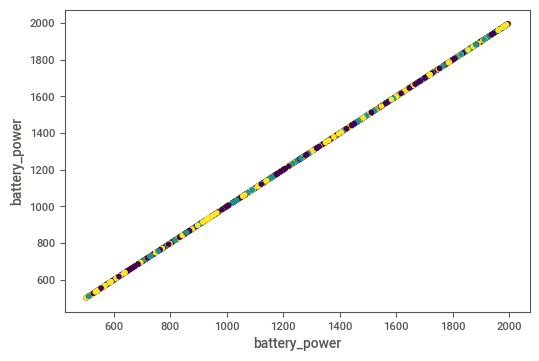

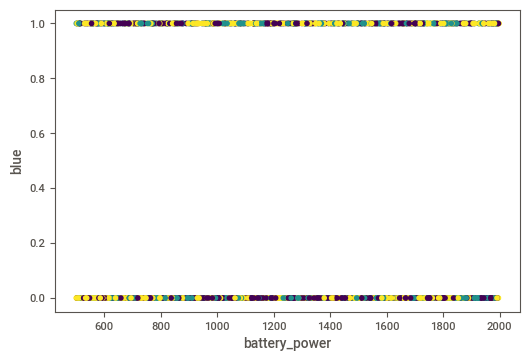

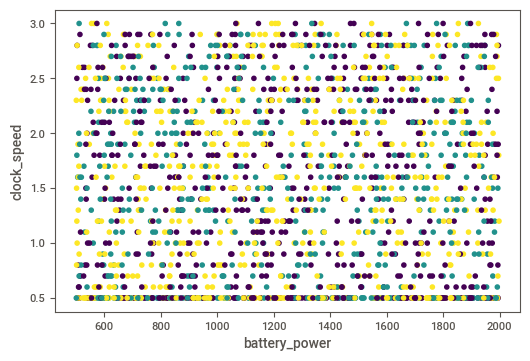

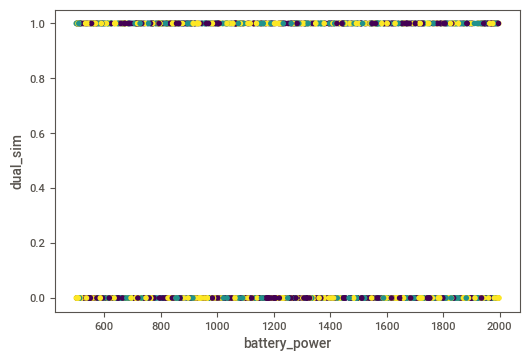

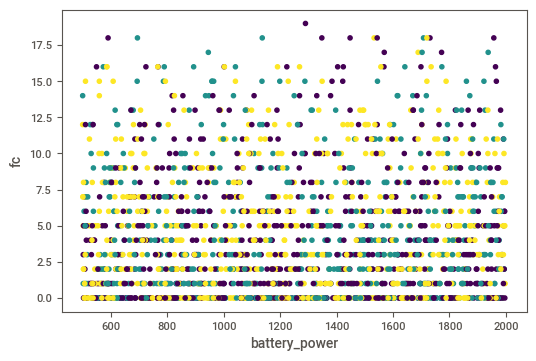

...

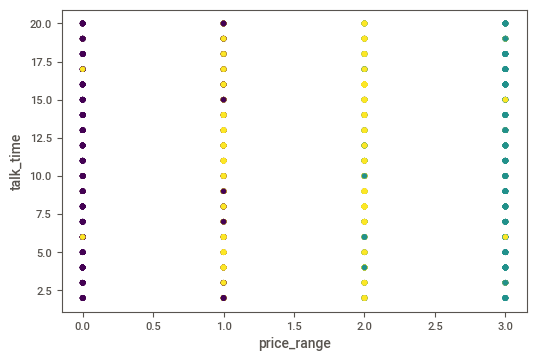

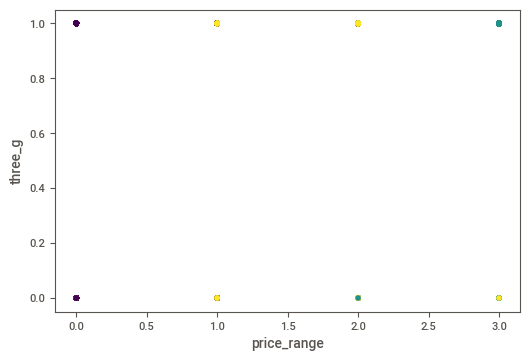

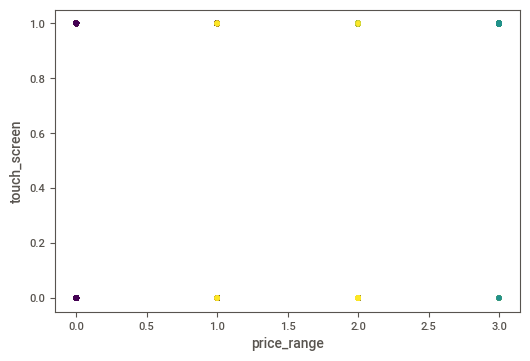

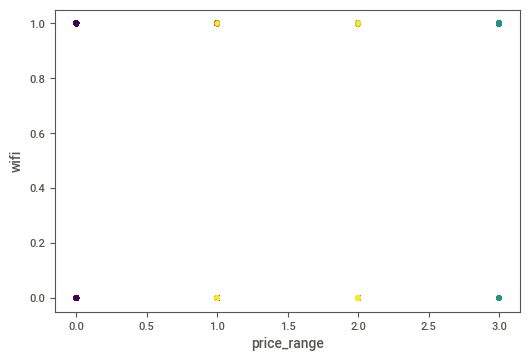

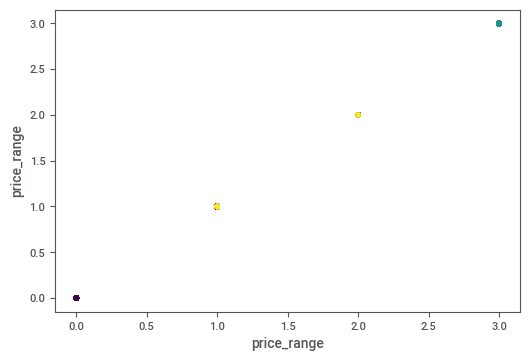

In [46]:
for a in raw_train.columns:
    for b in raw_train.columns:
        plt.scatter(raw_train[a], raw_train[b], c=y_pred_3)
        plt.xlabel(a)
        plt.ylabel(b)
        plt.show()

In [ ]:
y_pred_ram_bat = KMeans(n_clusters=2).fit_predict(raw_train[])